In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from math import pi
import os
import plotly.express as px
from statsmodels.stats.outliers_influence import variance_inflation_factor #para calcular los VIF

from google.colab import drive
from google.colab import files
drive.mount('/content/drive')

pd.set_option("display.max_columns", None)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Librerias a instalar
!apt-get install -y libpangocairo-1.0-0 libpangoft2-1.0-0 libgdk-pixbuf2.0-0 libffi-dev libcairo2
!pip install weasyprint
!pip install ipywidgets --quiet
!pip install lime
!pip install xgboost

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
libcairo2 is already the newest version (1.16.0-5ubuntu2).
libcairo2 set to manually installed.
libffi-dev is already the newest version (3.4.2-4).
libffi-dev set to manually installed.
libpangocairo-1.0-0 is already the newest version (1.50.6+ds-2ubuntu1).
libpangocairo-1.0-0 set to manually installed.
libpangoft2-1.0-0 is already the newest version (1.50.6+ds-2ubuntu1).
libpangoft2-1.0-0 set to manually installed.
The following additional packages will be installed:
  libgdk-pixbuf-xlib-2.0-0 libgdk-pixbuf2.0-bin
The following NEW packages will be installed:
  libgdk-pixbuf-xlib-2.0-0 libgdk-pixbuf2.0-0 libgdk-pixbuf2.0-bin
0 upgraded, 3 newly installed, 0 to remove and 35 not upgraded.
Need to get 59.3 kB of archives.
After this operation, 214 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/main amd64 libgdk-pixbuf-xlib-2.0-0 amd64 2.40.2-2build4 [4

In [ ]:
from sklearn.linear_model import LinearRegression
import sklearn.linear_model as linear_model
from sklearn import metrics
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import MinMaxScaler
import shap
shap.initjs()
from weasyprint import HTML
import ipywidgets as widgets
from IPython.display import display, HTML
import lime
from lime.lime_tabular import LimeTabularExplainer
import xgboost as xgb
from xgboost import XGBRegressor

In [ ]:
# Carga de los datos del drive sobre estadisticas de saque de jugadoras semi profesionales de superliga2
# de temporada 24/25 de volei femenino:

saques_temp2425 = pd.read_csv('/content/drive/MyDrive/universidad EUNCET - CTEF/TFG/TFG-TomaDatosSaqueVb2425-AleGravinaFabregat.csv')

In [ ]:
saques_temp2425.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 387 entries, 0 to 386
Data columns (total 16 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   Liga                387 non-null    object
 1   Eq_Local            387 non-null    object
 2   Eq_Visitante        387 non-null    object
 3   Jugadora_Saque      387 non-null    object
 4   Equipo_Saque        387 non-null    object
 5   Mano_Dominante      387 non-null    object
 6   Rol_Sac             387 non-null    object
 7   Tipo_Saque          387 non-null    object
 8   Zona_Saque          387 non-null    object
 9   Num_Set             387 non-null    int64 
 10  Marcador_Local      387 non-null    int64 
 11  Marcador_Visitante  387 non-null    int64 
 12  Col_Rival           387 non-null    object
 13  Zona_Recep          387 non-null    object
 14  Rol_Rec             387 non-null    object
 15  Valoracion_Saque    387 non-null    object
dtypes: int64(3), object(13)
me

# TRANSFORMACION

In [ ]:
# Anonimizar nombres de jugadoras por Proteccion de Datos

# Crear mapeo de nombres reales a genéricos
nombres_originales = saques_temp2425["Jugadora_Saque"].unique()
nombres_genericos = [f"Jugadora_{i+1}" for i in range(len(nombres_originales))]
mapa_anonimos = dict(zip(nombres_originales, nombres_genericos))

# Aplicar reemplazo
saques_temp2425["Jugadora_Saque"] = saques_temp2425["Jugadora_Saque"].map(mapa_anonimos)
saques_temp2425.head()

,Liga,Eq_Local,Eq_Visitante,Jugadora_Saque,Equipo_Saque,Mano_Dominante,Rol_Sac,Tipo_Saque,Zona_Saque,Num_Set,Marcador_Local,Marcador_Visitante,Col_Rival,Zona_Recep,Rol_Rec,Valoracion_Saque
0,Superliga2,CV_Sant_Cugat,Elite_volei,Jugadora_1,CV_Sant_Cugat,Derecha,Opuesta,Float_Salto,Zona1,1,9,3,R5,ZonaConflicto_16,Zaguera,!
1,Superliga2,CV_Sant_Cugat,Elite_volei,Jugadora_1,CV_Sant_Cugat,Derecha,Opuesta,Float_Salto,Zona1,1,21,13,R5,ZonaConflicto_16,Zaguera,-
2,Superliga2,CV_Sant_Cugat,Elite_volei,Jugadora_1,CV_Sant_Cugat,Derecha,Opuesta,Float_Salto,Zona1,2,4,4,R4,Zona5,Delantera,-
3,Superliga2,CV_Sant_Cugat,Elite_volei,Jugadora_1,CV_Sant_Cugat,Derecha,Opuesta,Float_Salto,Zona1,2,5,4,R4,ZonaConflicto_16,Libero,/
4,Superliga2,CV_Sant_Cugat,Elite_volei,Jugadora_1,CV_Sant_Cugat,Derecha,Opuesta,Float_Salto,Zona1,2,6,4,R4,Zona6,Zaguera,#


# CREACION NUEVAS VARIABLES

In [ ]:
# Creacion de una columna con la diferencia del marcador, teniendo en cuenta el resultado al momento del saque con la siguiente val:

# Valor positivo → el equipo que saca va ganando.
# Valor 0 → empate en el marcador.
# Valor negativo → el equipo que saca va perdiendo.

def calcular_dif_score(row):
  if row['Eq_Local'] == row['Equipo_Saque']:
    return row['Marcador_Local'] - row['Marcador_Visitante']
  else:
    return row['Marcador_Visitante'] - row['Marcador_Local']

saques_temp2425['Dif_Marcador_Saque'] = saques_temp2425.apply(calcular_dif_score, axis=1)


In [ ]:
saques_temp2425[["Eq_Local","Eq_Visitante","Jugadora_Saque","Equipo_Saque","Num_Set","Marcador_Local","Marcador_Visitante",'Dif_Marcador_Saque']].sample(20)

,Eq_Local,Eq_Visitante,Jugadora_Saque,Equipo_Saque,Num_Set,Marcador_Local,Marcador_Visitante,Dif_Marcador_Saque
341,CVS_UE,CVSJ,Jugadora_3,CVSJ,2,17,20,3
66,Esplugues,CV_Sant_Cugat,Jugadora_1,CV_Sant_Cugat,4,6,2,-4
297,Caep_S,CVSJ,Jugadora_3,CVSJ,5,2,5,3
122,Caep_S,CV_Sant_Cugat,Jugadora_1,CV_Sant_Cugat,1,19,23,4
356,CVSJ,CV_SAnt_Cugat,Jugadora_3,CVSJ,2,21,14,7
69,Esplugues,CV_Sant_Cugat,Jugadora_1,CV_Sant_Cugat,4,13,12,-1
5,CV_Sant_Cugat,Elite_volei,Jugadora_1,CV_Sant_Cugat,2,7,4,3
14,CV_Sant_Cugat,Elite_volei,Jugadora_1,CV_Sant_Cugat,3,22,14,8
240,CVSJ,Melilla,Jugadora_3,CVSJ,1,17,22,-5
13,CV_Sant_Cugat,Elite_volei,Jugadora_1,CV_Sant_Cugat,3,12,6,6


In [ ]:
# Revisar los valores unicos del TARGET sobre la columna "Valoracion_Saque":

saques_temp2425["Valoracion_Saque"].unique()

array(['!', '-', '/', '#', '+', '='], dtype=object)

In [ ]:
# Creacion de diccionarios con los posibles reemplazos de los valores del Saque

val_dicts = {
    # Transformarmos los valores a una escala 0 a 1
    "num": {"=":0, # Error directo en el saque
            "-":0.2,   # Saque fácil, recepción cómoda, permite jugar rapido con todos los ataques
            "!":0.55,  # Saque molesto, limita juego ofensivo, permite jugar rapido solo con bandas
            "+":0.80,  # Opción de ataque, pero limitada a una opcion o 2 pero con balon alto
            "/":0.90,  # Balón libre, sin primer ataque
            "#":1},      # Punto directo del saque
}

In [ ]:
# Crear una nueva columna Val_Saque_num pasando los valores de texto de la columna "Valoracion_Saque" a numerico

saques_temp2425["Val_Saque_num"] = saques_temp2425["Valoracion_Saque"].map(val_dicts["num"])
saques_temp2425.sample(30)

,Liga,Eq_Local,Eq_Visitante,Jugadora_Saque,Equipo_Saque,Mano_Dominante,Rol_Sac,Tipo_Saque,Zona_Saque,Num_Set,Marcador_Local,Marcador_Visitante,Col_Rival,Zona_Recep,Rol_Rec,Valoracion_Saque,Dif_Marcador_Saque,Val_Saque_num
278,Superliga2,CVSJ,CV_VallHebron,Jugadora_3,CVSJ,Derecha,Central,Float_Salto,Zona5,3,23,21,R4,Zona6,Libero,+,2,0.80
308,Superliga2,Premia_Dalt,CVSJ,Jugadora_3,CVSJ,Derecha,Central,Float_Salto,Zona5,1,2,0,R3,Zona6,Libero,-,-2,0.20
302,Superliga2,CVSJ,Esplues,Jugadora_3,CVSJ,Derecha,Central,Float_Salto,Zona5,1,16,16,R4,Zona6,Zaguera,!,0,0.55
9,Superliga2,CV_Sant_Cugat,Elite_volei,Jugadora_1,CV_Sant_Cugat,Derecha,Opuesta,Float_Salto,Zona1,3,3,4,R5,ZonaConflicto_56,Delantera,-,-1,0.20
223,Superliga2,Melilla,CVSJ,Jugadora_2,CVSJ,Derecha,Colocadora,Float_Salto,Zona1,3,17,11,R6,Zona6,Libero,-,-6,0.20
287,Superliga2,Caep_S,CVSJ,Jugadora_3,CVSJ,Derecha,Central,Float_Salto,Zona5,2,16,18,R2,Zona6,Zaguera,#,2,1.00
239,Superliga2,CVSJ,Melilla,Jugadora_3,CVSJ,Derecha,Central,Float_Salto,Zona5,1,16,22,R1,Zona5,Zaguera,+,-6,0.80
86,Superliga2,CV_Sant_Cugat,Premia_Dalt,Jugadora_1,CV_Sant_Cugat,Derecha,Opuesta,Float_Salto,Zona1,3,9,10,R4,Zona6,Zaguera,-,-1,0.20
95,Superliga2,Elite_volei,CV_Sant_Cugat,Jugadora_1,CV_Sant_Cugat,Derecha,Opuesta,Float_Salto,Zona1,3,17,20,R5,ZonaConflicto_56,Delantera,+,3,0.80
148,Superliga2,CVSJ,Melilla,Jugadora_2,CVSJ,Derecha,Colocadora,Float_Salto,Zona1,4,20,21,R5,ZonaConflicto_56,Zaguera,-,-1,0.20


In [ ]:
for jugadora, grupo in saques_temp2425.groupby("Jugadora_Saque"):
    var_name = f"df_{jugadora}"
    globals()[var_name] = grupo.reset_index(drop=True)

In [ ]:
# Calcular media y desviacion estándar de los últimos 3 saques por jugadora
def media_std_ultimos_tres_con_actual(df):
    df = df.copy()

    # Crear columna de ID único por partido
    df["Partido_ID"] = df["Eq_Local"] + "_" + df["Eq_Visitante"]

    # Asegurar orden temporal dentro del partido
    df.sort_values(by=["Jugadora_Saque", "Partido_ID", "Num_Set"], inplace=True)

    # Agrupar por jugadora y partido
    def aplicar_rolling(gr):
        # Rolling para media y std con ventana 3 (incluyendo actual)
        gr["media_3_saques_num"] = gr["Val_Saque_num"].rolling(window=3, min_periods=3).mean()
        gr["std_3_saques_num"] = gr["Val_Saque_num"].rolling(window=3, min_periods=3).std(ddof=0)

        return gr

    # Aplicar rolling por grupo
    df = df.groupby(["Jugadora_Saque", "Partido_ID"], group_keys=False).apply(aplicar_rolling)

    # Limpieza final
    df.drop(columns=["Partido_ID"], inplace=True)
    #df = df.dropna(subset=["ratio"])

    return df

# Aplicar al DataFrame
saques_temp2425 = media_std_ultimos_tres_con_actual(saques_temp2425)
saques_temp2425.head(20)

<ipython-input-13-cd1d7ec8e5d4>:20: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby(["Jugadora_Saque", "Partido_ID"], group_keys=False).apply(aplicar_rolling)


,Liga,Eq_Local,Eq_Visitante,Jugadora_Saque,Equipo_Saque,Mano_Dominante,Rol_Sac,Tipo_Saque,Zona_Saque,Num_Set,Marcador_Local,Marcador_Visitante,Col_Rival,Zona_Recep,Rol_Rec,Valoracion_Saque,Dif_Marcador_Saque,Val_Saque_num,media_3_saques_num,std_3_saques_num
127,Superliga2,CV_Sant_Cugat,Barça,Jugadora_1,CV_Sant_Cugat,Derecha,Opuesta,Float_Salto,Zona1,1,3,4,R5,Zona6,Zaguera,#,-1,1.00,NaN,NaN
128,Superliga2,CV_Sant_Cugat,Barça,Jugadora_1,CV_Sant_Cugat,Derecha,Opuesta,Float_Salto,Zona1,1,4,4,R5,Zona6,Zaguera,#,0,1.00,NaN,NaN
129,Superliga2,CV_Sant_Cugat,Barça,Jugadora_1,CV_Sant_Cugat,Derecha,Opuesta,Float_Salto,Zona1,1,5,4,R5,Zona1,Libero,+,1,0.80,0.933333,0.094281
130,Superliga2,CV_Sant_Cugat,Barça,Jugadora_1,CV_Sant_Cugat,Derecha,Opuesta,Float_Salto,Zona1,1,6,4,R5,Zona6,Zaguera,=,2,0.00,0.600000,0.432049
131,Superliga2,CV_Sant_Cugat,Barça,Jugadora_1,CV_Sant_Cugat,Derecha,Opuesta,Float_Salto,Zona1,1,15,12,R5,ZonaConflicto_56,Zaguera,#,3,1.00,0.600000,0.432049
132,Superliga2,CV_Sant_Cugat,Barça,Jugadora_1,CV_Sant_Cugat,Derecha,Opuesta,Float_Salto,Zona1,1,16,12,R5,Zona6,Zaguera,+,4,0.80,0.600000,0.432049
133,Superliga2,CV_Sant_Cugat,Barça,Jugadora_1,CV_Sant_Cugat,Derecha,Opuesta,Float_Salto,Zona1,1,23,20,R5,Zona6,Zaguera,-,3,0.20,0.666667,0.339935
134,Superliga2,CV_Sant_Cugat,Barça,Jugadora_1,CV_Sant_Cugat,Derecha,Opuesta,Float_Salto,Zona1,2,3,2,R6,Zona6,Libero,!,1,0.55,0.516667,0.246080
135,Superliga2,CV_Sant_Cugat,Barça,Jugadora_1,CV_Sant_Cugat,Derecha,Opuesta,Float_Salto,Zona1,2,11,11,R6,Zona6,Libero,+,0,0.80,0.516667,0.246080
136,Superliga2,CV_Sant_Cugat,Barça,Jugadora_1,CV_Sant_Cugat,Derecha,Opuesta,Float_Salto,Zona1,3,3,3,R5,ZonaConflicto_56,Zaguera,-,0,0.20,0.516667,0.246080


In [ ]:
saques_temp2425.info()

<class 'pandas.core.frame.DataFrame'>
Index: 387 entries, 127 to 319
Data columns (total 20 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Liga                387 non-null    object 
 1   Eq_Local            387 non-null    object 
 2   Eq_Visitante        387 non-null    object 
 3   Jugadora_Saque      387 non-null    object 
 4   Equipo_Saque        387 non-null    object 
 5   Mano_Dominante      387 non-null    object 
 6   Rol_Sac             387 non-null    object 
 7   Tipo_Saque          387 non-null    object 
 8   Zona_Saque          387 non-null    object 
 9   Num_Set             387 non-null    int64  
 10  Marcador_Local      387 non-null    int64  
 11  Marcador_Visitante  387 non-null    int64  
 12  Col_Rival           387 non-null    object 
 13  Zona_Recep          387 non-null    object 
 14  Rol_Rec             387 non-null    object 
 15  Valoracion_Saque    387 non-null    object 
 16  Dif_Marcado

In [ ]:
saques_temp2425["Zona_Saque"].unique()

array(['Zona1', 'Zona5', 'Zona6'], dtype=object)

In [ ]:
saques_temp2425["Zona_Recep"].unique()

array(['Zona6', 'Zona1', 'ZonaConflicto_56', 'Zona5', 'ZonaConflicto_16'],
      dtype=object)

In [ ]:
# Crear una nueva columna llamada "Direccion" donde tome los valores primero de "Zona_Saque" y "Zona_Recep",
# y si el resultado es 'Zona1Zona5', 'Zona6Zona6', 'Zona5Zona1', 'Zona5ZonaConflicto_16', 'Zona6ZonaConflicto_16',
# 'Zona6ZonaConflicto_56', 'Zona1ZonaConflicto_56'= el resultado sea "Paralelo".
# luego si es 'Zona1Zona1', 'Zona5Zona5', "Zona1ZonaConflicto_16", "Zona5ZonaConflicto_56" = el resultado sea "Diagonal_Larga"
# El resto "Diagonal_Corta"

def clasificar_direccion(z_saque, z_recep):
    comb = str(z_saque) + str(z_recep)
    if comb in {'Zona1Zona5', 'Zona6Zona6', 'Zona5Zona1', 'Zona5ZonaConflicto_16', 'Zona6ZonaConflicto_16',
                'Zona6ZonaConflicto_56', 'Zona1ZonaConflicto_56'}:
        return "Paralelo"
    elif comb in {'Zona1Zona1', 'Zona5Zona5', "Zona1ZonaConflicto_16", "Zona5ZonaConflicto_56"}:
        return "Diagonal_Larga"
    return "Diagonal_Corta"

saques_temp2425['Direccion_saque'] = saques_temp2425.apply(
    lambda row: clasificar_direccion(row['Zona_Saque'], row['Zona_Recep']), axis=1
)

In [ ]:
saques_temp2425[['Zona_Saque','Zona_Recep','Direccion_saque']].sample(15)

,Zona_Saque,Zona_Recep,Direccion_saque
236,Zona1,ZonaConflicto_56,Paralelo
241,Zona5,Zona5,Diagonal_Larga
208,Zona1,Zona6,Diagonal_Corta
21,Zona1,ZonaConflicto_56,Paralelo
40,Zona1,Zona5,Paralelo
194,Zona1,ZonaConflicto_56,Paralelo
172,Zona1,Zona1,Diagonal_Larga
19,Zona1,ZonaConflicto_56,Paralelo
342,Zona5,ZonaConflicto_56,Diagonal_Larga
68,Zona1,Zona6,Diagonal_Corta


In [ ]:
saques_temp2425["Col_Rival"].unique()

array(['R5', 'R6', 'R3', 'R4', 'R1', 'R2'], dtype=object)

In [ ]:
# Se crea una nueva columna "Pos_Col_Rival" donde reemplazamos los valores de la columna "Col_Rival" de R3 y R6 por el valor "R3_R6",
# y los valores R2, R4 y R5 por el valor agrupado "R2_R4_R5", para disminuir las cantidad de posibilidades.

saques_temp2425["Col_Rival_agrupado"] = saques_temp2425["Col_Rival"].replace(
    {"R3": "R3_R6", "R6": "R3_R6", "R2": "R2_R4_R5", "R4": "R2_R4_R5", "R5": "R2_R4_R5"}
)
saques_temp2425[["Col_Rival", "Col_Rival_agrupado"]].head(20)


,Col_Rival,Col_Rival_agrupado
127,R5,R2_R4_R5
128,R5,R2_R4_R5
129,R5,R2_R4_R5
130,R5,R2_R4_R5
131,R5,R2_R4_R5
132,R5,R2_R4_R5
133,R5,R2_R4_R5
134,R6,R3_R6
135,R6,R3_R6
136,R5,R2_R4_R5


In [ ]:
saques_temp2425["Col_Rival_agrupado"].unique()

array(['R2_R4_R5', 'R3_R6', 'R1'], dtype=object)

In [ ]:
# Visualizo la informacion de las variables a descartar pero relevantes para el estudio de cada jugadora:
# "Mano_Dominante", "Rol_Sac", "Tipo_Saque" y "Zona_Saque"

def crear_contexto_desde_dataframe(df):
    """
    Construye un diccionario contexto_jugadora desde el DataFrame original,
    incluyendo visualización de valores únicos por jugadora.
    """
    contexto = {}

    for jugadora in df["Jugadora_Saque"].unique():
        subset = df[df["Jugadora_Saque"] == jugadora]

        # Extraer valores únicos (no nulos) de cada campo
        mano = subset["Mano_Dominante"].dropna().unique()
        rol = subset["Rol_Sac"].dropna().unique()
        tipo = subset["Tipo_Saque"].dropna().unique()
        zona = subset["Zona_Saque"].dropna().unique()

        # Visualización
        print(f"🎯 Jugadora: {jugadora}")
        print("   🖐 Mano_Dominante:", mano)
        print("   🧩 Rol_Sac:", rol)
        print("   🌀 Tipo_Saque:", tipo)
        print("   📍 Zona_Saque:", zona)
        print("-" * 50)

        # Agregar al diccionario (usar solo el primer valor si hay uno único)
        contexto[jugadora] = {
            "Mano_Dominante": mano[0] if len(mano) == 1 else list(mano),
            "Rol_Sac": rol[0] if len(rol) == 1 else list(rol),
            "Tipo_Saque": tipo[0] if len(tipo) == 1 else list(tipo),
            "Zona_Saque": zona[0] if len(zona) == 1 else list(zona),
        }

    return contexto
# Crear el contexto y mostrar la info por consola
contexto_jugadora = crear_contexto_desde_dataframe(saques_temp2425)

🎯 Jugadora: Jugadora_1
   🖐 Mano_Dominante: ['Derecha']
   🧩 Rol_Sac: ['Opuesta']
   🌀 Tipo_Saque: ['Float_Salto']
   📍 Zona_Saque: ['Zona1']
--------------------------------------------------
🎯 Jugadora: Jugadora_2
   🖐 Mano_Dominante: ['Derecha']
   🧩 Rol_Sac: ['Colocadora']
   🌀 Tipo_Saque: ['Float_Salto']
   📍 Zona_Saque: ['Zona1']
--------------------------------------------------
🎯 Jugadora: Jugadora_3
   🖐 Mano_Dominante: ['Derecha']
   🧩 Rol_Sac: ['Central']
   🌀 Tipo_Saque: ['Float_Salto']
   📍 Zona_Saque: ['Zona5' 'Zona6']
--------------------------------------------------


In [ ]:
saques_temp2425 = saques_temp2425.dropna(subset=["media_3_saques_num"])
saques_temp2425.info()

<class 'pandas.core.frame.DataFrame'>
Index: 319 entries, 129 to 319
Data columns (total 22 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Liga                319 non-null    object 
 1   Eq_Local            319 non-null    object 
 2   Eq_Visitante        319 non-null    object 
 3   Jugadora_Saque      319 non-null    object 
 4   Equipo_Saque        319 non-null    object 
 5   Mano_Dominante      319 non-null    object 
 6   Rol_Sac             319 non-null    object 
 7   Tipo_Saque          319 non-null    object 
 8   Zona_Saque          319 non-null    object 
 9   Num_Set             319 non-null    int64  
 10  Marcador_Local      319 non-null    int64  
 11  Marcador_Visitante  319 non-null    int64  
 12  Col_Rival           319 non-null    object 
 13  Zona_Recep          319 non-null    object 
 14  Rol_Rec             319 non-null    object 
 15  Valoracion_Saque    319 non-null    object 
 16  Dif_Marcado

In [ ]:
# Definimos las columnas a eliminar para el estudio

# Variables base
columns_drop = ['Liga', # porque solamente se extrajeron datos de Superliga 2
                'Eq_Local', # Necesario para calcular la Diferencia del marcador solamente
                'Eq_Visitante', # Necesario para calcular la Diferencia del marcador solamente
                'Jugadora_Saque',
                'Equipo_Saque', # Necesario para calcular la Diferencia del marcador solamente
                'Mano_Dominante', # Las jugadoras sacaban siempre con la misma mano
                'Rol_Sac', # El rol de juego de la sacadora no cambia, podria ser util en analis de equipo
                'Tipo_Saque', # Las jugadoras solo sacan con 1 tipo de saque
                'Zona_Saque', # En el alto rendimiento sacan siempre de la misma zona y sirvio para la variable simplificada Direccion_Saque
                'Num_Set', # pocos datos individuales por set
                'Marcador_Local', # Importante para calcular diferencia del marcador
                'Marcador_Visitante', # Importante para calcular diferencia del marcador
                'Col_Rival', # Se transformo a una variable simplificada Col_Rival_agrupado
                'Zona_Recep', # Se transformo a una variable simplificada Direccion_saque
                'Valoracion_Saque'] # Luego de la transformacion numerica de Val_Saque_num

# Definimos las variables predictoras y las variables a predecir (target).
target = "Val_Saque_num"


In [ ]:
# realizamos un Dataframe para cada jugadora
Saques_Jug1 = saques_temp2425[saques_temp2425["Jugadora_Saque"] == "Jugadora_1"]
Saques_Jug2 = saques_temp2425[saques_temp2425["Jugadora_Saque"] == "Jugadora_2"]
Saques_Jug3 = saques_temp2425[saques_temp2425["Jugadora_Saque"] == "Jugadora_3"]

In [ ]:
# Paso 1: Creacion DataFrame finales para el modelado
Saques_Jug1_final = Saques_Jug1.drop(columns=columns_drop)
Saques_Jug2_final = Saques_Jug2.drop(columns=columns_drop)
Saques_Jug3_final = Saques_Jug3.drop(columns=columns_drop)

# Paso 2: Detectar columnas categóricas automáticamente
columnas_categoricas = Saques_Jug1_final.select_dtypes(include=["object"]).columns.tolist()

# Paso 3: Codificar variables categóricas
Saques_Jug1_final = pd.get_dummies(Saques_Jug1_final, columns=columnas_categoricas, drop_first=True)
Saques_Jug2_final = pd.get_dummies(Saques_Jug2_final, columns=columnas_categoricas, drop_first=True)
Saques_Jug3_final = pd.get_dummies(Saques_Jug3_final, columns=columnas_categoricas, drop_first=True)

In [ ]:
# Diccionario con los nombres de las jugadoras y sus DataFrames
dataframes_jugadoras = {
    "Jugadora_1": Saques_Jug1_final,
    "Jugadora_2": Saques_Jug2_final,
    "Jugadora_3": Saques_Jug3_final
}

In [ ]:
Saques_Jug1_final.info()

<class 'pandas.core.frame.DataFrame'>
Index: 117 entries, 129 to 72
Data columns (total 10 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Dif_Marcador_Saque              117 non-null    int64  
 1   Val_Saque_num                   117 non-null    float64
 2   media_3_saques_num              117 non-null    float64
 3   std_3_saques_num                117 non-null    float64
 4   Rol_Rec_Libero                  117 non-null    bool   
 5   Rol_Rec_Zaguera                 117 non-null    bool   
 6   Direccion_saque_Diagonal_Larga  117 non-null    bool   
 7   Direccion_saque_Paralelo        117 non-null    bool   
 8   Col_Rival_agrupado_R2_R4_R5     117 non-null    bool   
 9   Col_Rival_agrupado_R3_R6        117 non-null    bool   
dtypes: bool(6), float64(3), int64(1)
memory usage: 5.3 KB


#  Estadísticos descriptivos de variables numéricas

In [ ]:
Saques_Jug1_final[["Dif_Marcador_Saque","Val_Saque_num","media_3_saques_num","std_3_saques_num"]].describe()

,Dif_Marcador_Saque,Val_Saque_num,media_3_saques_num,std_3_saques_num
count,117.000000,117.000000,117.000000,117.000000
mean,1.777778,0.479060,0.484758,0.257553
std,3.238005,0.345989,0.201593,0.122361
min,-4.000000,0.000000,0.066667,0.000000
25%,0.000000,0.200000,0.333333,0.164992
50%,2.000000,0.550000,0.516667,0.282843
75%,4.000000,0.800000,0.600000,0.339935
max,10.000000,1.000000,0.933333,0.471405


In [ ]:
Saques_Jug2_final.info()

<class 'pandas.core.frame.DataFrame'>
Index: 76 entries, 228 to 178
Data columns (total 10 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Dif_Marcador_Saque              76 non-null     int64  
 1   Val_Saque_num                   76 non-null     float64
 2   media_3_saques_num              76 non-null     float64
 3   std_3_saques_num                76 non-null     float64
 4   Rol_Rec_Libero                  76 non-null     bool   
 5   Rol_Rec_Zaguera                 76 non-null     bool   
 6   Direccion_saque_Diagonal_Larga  76 non-null     bool   
 7   Direccion_saque_Paralelo        76 non-null     bool   
 8   Col_Rival_agrupado_R2_R4_R5     76 non-null     bool   
 9   Col_Rival_agrupado_R3_R6        76 non-null     bool   
dtypes: bool(6), float64(3), int64(1)
memory usage: 3.4 KB


In [ ]:
Saques_Jug2_final[["Dif_Marcador_Saque","Val_Saque_num","media_3_saques_num","std_3_saques_num"]].describe()

,Dif_Marcador_Saque,Val_Saque_num,media_3_saques_num,std_3_saques_num
count,76.000000,76.000000,76.000000,76.000000
mean,0.263158,0.386184,0.398026,0.213811
std,4.158103,0.320687,0.197071,0.126233
min,-12.000000,0.000000,0.066667,0.000000
25%,-1.000000,0.200000,0.200000,0.094281
50%,0.000000,0.200000,0.400000,0.246080
75%,2.000000,0.800000,0.550000,0.315382
max,12.000000,1.000000,0.800000,0.432049


In [ ]:
Saques_Jug3_final.info()

<class 'pandas.core.frame.DataFrame'>
Index: 126 entries, 352 to 319
Data columns (total 10 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Dif_Marcador_Saque              126 non-null    int64  
 1   Val_Saque_num                   126 non-null    float64
 2   media_3_saques_num              126 non-null    float64
 3   std_3_saques_num                126 non-null    float64
 4   Rol_Rec_Libero                  126 non-null    bool   
 5   Rol_Rec_Zaguera                 126 non-null    bool   
 6   Direccion_saque_Diagonal_Larga  126 non-null    bool   
 7   Direccion_saque_Paralelo        126 non-null    bool   
 8   Col_Rival_agrupado_R2_R4_R5     126 non-null    bool   
 9   Col_Rival_agrupado_R3_R6        126 non-null    bool   
dtypes: bool(6), float64(3), int64(1)
memory usage: 5.7 KB


In [ ]:
Saques_Jug3_final[["Dif_Marcador_Saque","Val_Saque_num","media_3_saques_num","std_3_saques_num"]].describe()

,Dif_Marcador_Saque,Val_Saque_num,media_3_saques_num,std_3_saques_num
count,126.000000,126.000000,126.000000,126.000000
mean,1.888889,0.504365,0.502116,0.216787
std,4.675420,0.316987,0.207343,0.110719
min,-14.000000,0.000000,0.000000,0.000000
25%,0.000000,0.200000,0.341667,0.164992
50%,2.000000,0.550000,0.450000,0.252676
75%,5.000000,0.800000,0.633333,0.309121
max,12.000000,1.000000,0.966667,0.402768


# ANALISIS columna Val_Saque_num

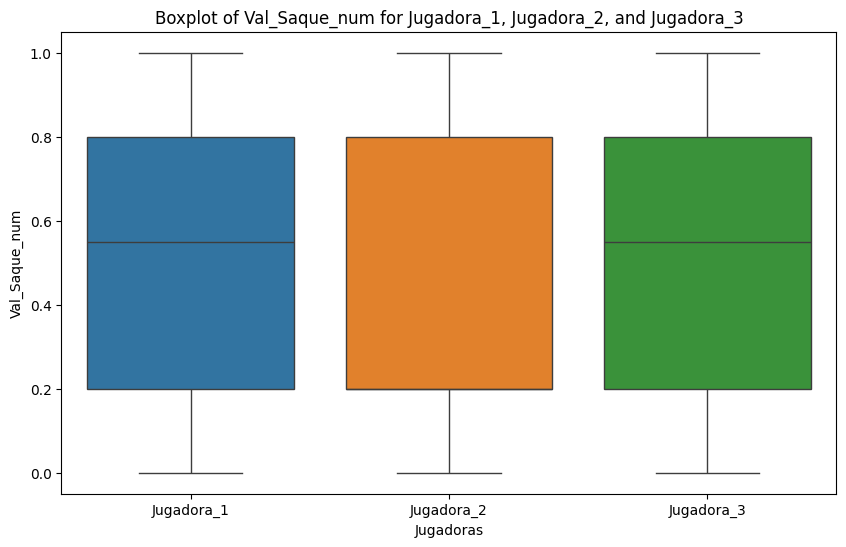

In [ ]:
# Visualizacion de los 3 dataframe con la columna Val_Saque_num
all_val_saque = pd.concat([
    Saques_Jug1_final['Val_Saque_num'].rename('Jugadora_1'),
    Saques_Jug2_final['Val_Saque_num'].rename('Jugadora_2'),
    Saques_Jug3_final['Val_Saque_num'].rename('Jugadora_3')
], axis=1)

# Create the boxplot
plt.figure(figsize=(10, 6))
sns.boxplot(data=all_val_saque)
plt.title('Boxplot of Val_Saque_num for Jugadora_1, Jugadora_2, and Jugadora_3')
plt.ylabel('Val_Saque_num')
plt.xlabel('Jugadoras')
plt.show()

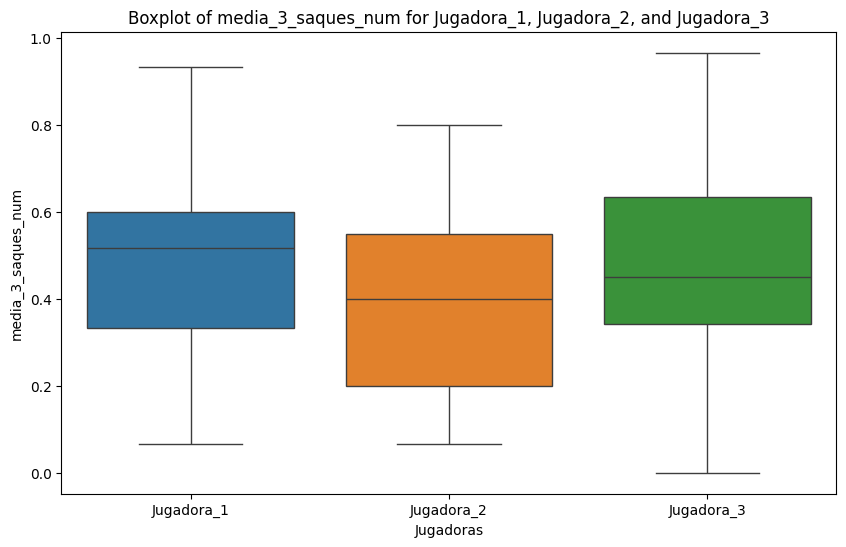

In [ ]:
# Visualizacion de los 3 dataframe con la columna media_3_saques_num
all_media_3_saques_num = pd.concat([
    Saques_Jug1_final['media_3_saques_num'].rename('Jugadora_1'),
    Saques_Jug2_final['media_3_saques_num'].rename('Jugadora_2'),
    Saques_Jug3_final['media_3_saques_num'].rename('Jugadora_3')
], axis=1)

# Create the boxplot
plt.figure(figsize=(10, 6))
sns.boxplot(data=all_media_3_saques_num)
plt.title('Boxplot of media_3_saques_num for Jugadora_1, Jugadora_2, and Jugadora_3')
plt.ylabel('media_3_saques_num')
plt.xlabel('Jugadoras')
plt.show()


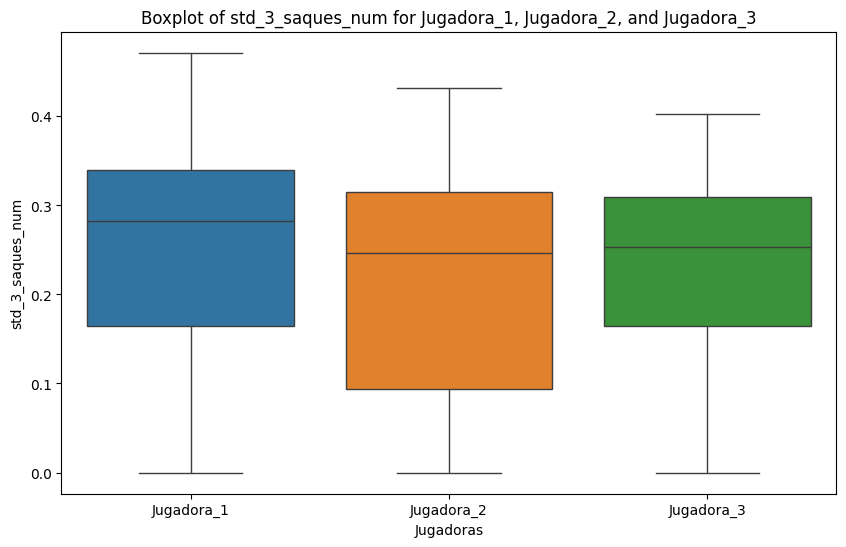

In [ ]:
# Visualizacion de los 3 dataframe con la columna std_3_saques_num
all_std_3_saques_num = pd.concat([
    Saques_Jug1_final['std_3_saques_num'].rename('Jugadora_1'),
    Saques_Jug2_final['std_3_saques_num'].rename('Jugadora_2'),
    Saques_Jug3_final['std_3_saques_num'].rename('Jugadora_3')
], axis=1)

# Create the boxplot
plt.figure(figsize=(10, 6))
sns.boxplot(data=all_std_3_saques_num)
plt.title('Boxplot of std_3_saques_num for Jugadora_1, Jugadora_2, and Jugadora_3')
plt.ylabel('std_3_saques_num')
plt.xlabel('Jugadoras')
plt.show()

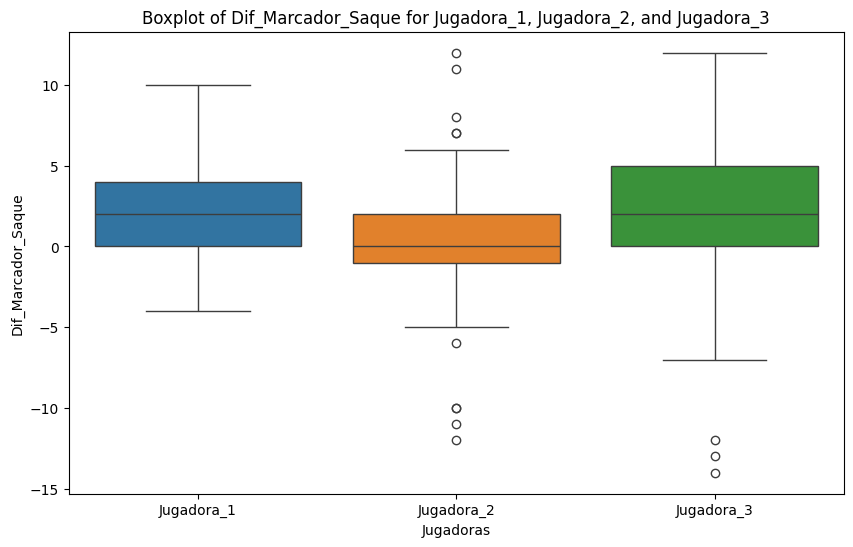

In [ ]:
# Visualizacion de los 3 dataframe con la columna Dif_Marcador_Saque
all_dif_marcador = pd.concat([
    Saques_Jug1_final['Dif_Marcador_Saque'].rename('Jugadora_1'),
    Saques_Jug2_final['Dif_Marcador_Saque'].rename('Jugadora_2'),
    Saques_Jug3_final['Dif_Marcador_Saque'].rename('Jugadora_3')
], axis=1)

# Create the boxplot
plt.figure(figsize=(10, 6))
sns.boxplot(data=all_dif_marcador)
plt.title('Boxplot of Dif_Marcador_Saque for Jugadora_1, Jugadora_2, and Jugadora_3')
plt.ylabel('Dif_Marcador_Saque')
plt.xlabel('Jugadoras')
plt.show()

# ANALISIS JUGADORA 1

In [ ]:
px.scatter_matrix(Saques_Jug1_final,dimensions=["Val_Saque_num","media_3_saques_num","std_3_saques_num","Dif_Marcador_Saque"])

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 128270 (\N{RIGHT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.



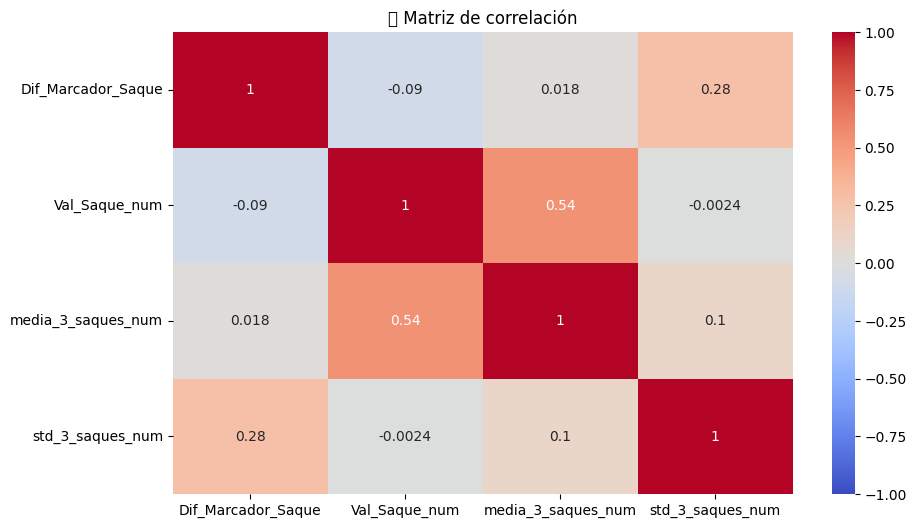

In [ ]:
# Revisar y guardar las columnas que son numericas
df_numericas = Saques_Jug1_final.select_dtypes(include=["float64", "int64"])

# Matriz de correlación
plt.figure(figsize=(10, 6))
sns.heatmap(df_numericas.corr(), annot=True, cmap="coolwarm", vmin=-1, vmax=1)
plt.title("🔎 Matriz de correlación")
plt.show()

# ANALISIS JUGADORA 2

In [ ]:
px.scatter_matrix(Saques_Jug2_final,dimensions=["Val_Saque_num","media_3_saques_num","std_3_saques_num","Dif_Marcador_Saque"])

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 128270 (\N{RIGHT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.



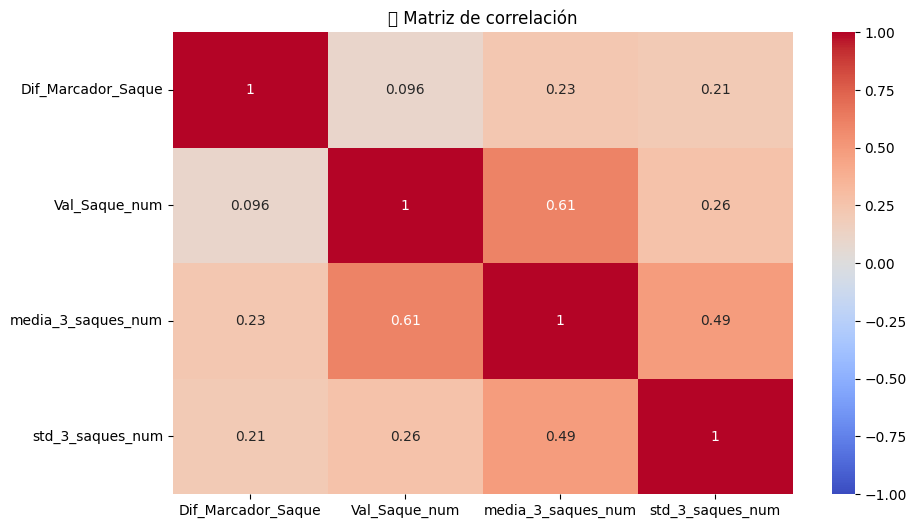

In [ ]:
# Revisar y guardar las columnas que son numericas
df_numericas = Saques_Jug2_final.select_dtypes(include=["float64", "int64"])

# Matriz de correlación
plt.figure(figsize=(10, 6))
sns.heatmap(df_numericas.corr(), annot=True, cmap="coolwarm", vmin=-1, vmax=1)
plt.title("🔎 Matriz de correlación")
plt.show()

# ANALISIS JUGADORA 3

In [ ]:
px.scatter_matrix(Saques_Jug3_final,dimensions=["Val_Saque_num","media_3_saques_num","std_3_saques_num","Dif_Marcador_Saque"])

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 128270 (\N{RIGHT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.



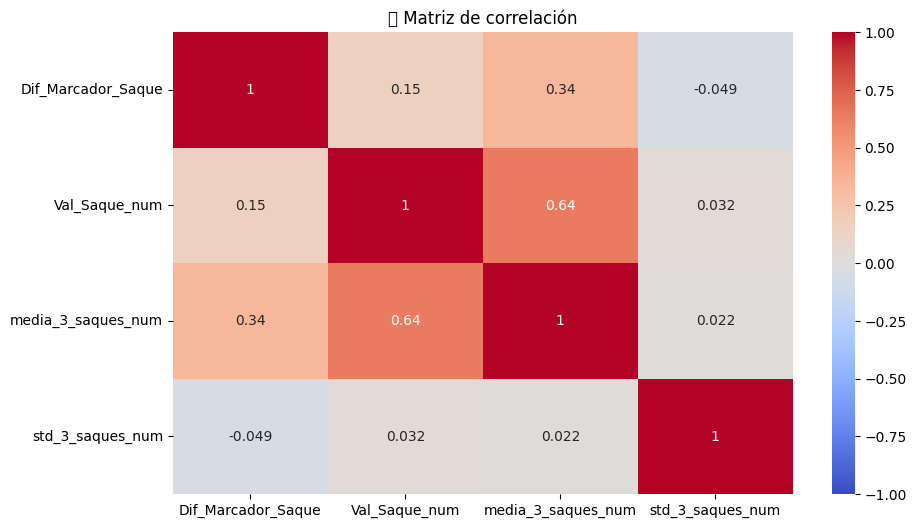

In [ ]:
# Revisar y guardar las columnas que son numericas
df_numericas = Saques_Jug3_final.select_dtypes(include=["float64", "int64"])

# Matriz de correlación
plt.figure(figsize=(10, 6))
sns.heatmap(df_numericas.corr(), annot=True, cmap="coolwarm", vmin=-1, vmax=1)
plt.title("🔎 Matriz de correlación")
plt.show()

# Calculo e Interpretación del VIF:
VIF	Significado
# 1–5	Colinealidad aceptable ✅
# > 5	Posible colinealidad ⚠️
# > 10	Alta colinealidad ❌ (deberías actuar)

In [ ]:
# Lista de DataFrames por jugadora
dataframes_jugadoras = {
    "Jugadora_1": Saques_Jug1_final,
    "Jugadora_2": Saques_Jug2_final,
    "Jugadora_3": Saques_Jug3_final
}

# Calcular VIF por jugadora
for nombre, df in dataframes_jugadoras.items():
    X = df.drop(columns=["Val_Saque_num"])  # Dejar solo las features

    # Convertir todas las columnas a float64 para evitar errores
    X = X.astype("float64")

    # Cálculo del VIF
    vif_df = pd.DataFrame()
    vif_df["Variable"] = X.columns
    vif_df["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

    print(f"\n📊 VIF para {nombre}")
    display(vif_df.sort_values("VIF", ascending=False))


📊 VIF para Jugadora_1


,Variable,VIF
2,std_3_saques_num,6.252321
1,media_3_saques_num,6.240289
7,Col_Rival_agrupado_R2_R4_R5,3.706947
6,Direccion_saque_Paralelo,3.107477
4,Rol_Rec_Zaguera,2.634090
8,Col_Rival_agrupado_R3_R6,2.544554
3,Rol_Rec_Libero,2.512478
5,Direccion_saque_Diagonal_Larga,1.854920
0,Dif_Marcador_Saque,1.528643



📊 VIF para Jugadora_2


,Variable,VIF
1,media_3_saques_num,6.500496
2,std_3_saques_num,5.333979
7,Col_Rival_agrupado_R2_R4_R5,3.934909
8,Col_Rival_agrupado_R3_R6,3.466034
4,Rol_Rec_Zaguera,2.990050
6,Direccion_saque_Paralelo,2.612686
3,Rol_Rec_Libero,2.378019
5,Direccion_saque_Diagonal_Larga,2.079549
0,Dif_Marcador_Saque,1.192980



📊 VIF para Jugadora_3


,Variable,VIF
1,media_3_saques_num,6.553404
2,std_3_saques_num,4.643687
7,Col_Rival_agrupado_R2_R4_R5,3.583773
3,Rol_Rec_Libero,3.063997
4,Rol_Rec_Zaguera,2.871567
8,Col_Rival_agrupado_R3_R6,2.860609
5,Direccion_saque_Diagonal_Larga,1.948610
6,Direccion_saque_Paralelo,1.761749
0,Dif_Marcador_Saque,1.583549


In [ ]:
#Comprobamos la colinealidad de variables.

px.scatter(Saques_Jug1_final, x='media_3_saques_num', y='std_3_saques_num',
           trendline = 'ols', trendline_color_override='red')

In [ ]:
#Comprobamos la colinealidad de variables.

px.scatter(Saques_Jug2_final, x='media_3_saques_num', y='std_3_saques_num',
           trendline = 'ols', trendline_color_override='red')

In [ ]:
#Comprobamos la colinealidad de variables.

px.scatter(Saques_Jug3_final, x='media_3_saques_num', y='std_3_saques_num',
           trendline = 'ols', trendline_color_override='red')

# Codigo para descargar Dataframes finales de jugadoras

In [ ]:
# Diccionario con los nombres de los DataFrames y sus nombres de archivo deseados
dataframes_to_save = {
    "Saques_Jug1_final": Saques_Jug1_final,
    "Saques_Jug2_final": Saques_Jug2_final,
    "Saques_Jug3_final": Saques_Jug3_final
}

# Descargar cada DataFrame a un archivo Excel
for df_name, df_data in dataframes_to_save.items():
    file_path = f'{df_name}.xlsx'
    df_data.to_excel(file_path, index=False)
    print(f'DataFrame "{df_name}" guardado como "{file_path}"')

    # Opcional: descargar el archivo directamente en Google Colab
    try:
        files.download(file_path)
        print(f'Archivo "{file_path}" descargado.')
    except Exception as e:
        print(f'No se pudo descargar "{file_path}": {e}')

DataFrame "Saques_Jug1_final" guardado como "Saques_Jug1_final.xlsx"


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Archivo "Saques_Jug1_final.xlsx" descargado.
DataFrame "Saques_Jug2_final" guardado como "Saques_Jug2_final.xlsx"


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Archivo "Saques_Jug2_final.xlsx" descargado.
DataFrame "Saques_Jug3_final" guardado como "Saques_Jug3_final.xlsx"


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Archivo "Saques_Jug3_final.xlsx" descargado.


# COMIENZA EL PROCESADO PARA LA REGRESION

# Funcion para modelo lineal

In [ ]:
# Funcion para modelo lineal

def imprimir_resultados_modelo_lineal(res, X_cols):
    modelo = res["modelo"]
    print("📌 Punto de corte (intercepto):", modelo.intercept_)

    print("📈 Coeficientes:")
    for var, coef in zip(X_cols, modelo.coef_):
        print(f"   • {var}: {coef.item():.4f}")

    # Métricas adicionales
    mae = mean_absolute_error(res["y_test"], res["y_pred"])
    rmse = np.sqrt(res["MSE"])

    print("\n📊 Métricas de evaluación:")
    print(f"• MAE  (Error absoluto medio):     {mae:.4f}")
    print(f"• MSE  (Error cuadrático medio):    {res['MSE']:.4f}")
    print(f"• RMSE (Raíz del error cuadrático): {rmse:.4f}")
    print(f"• R²   (Coeficiente de determinación): {res['R2']:.4f}")


In [ ]:
# Funciones personalizadas para visualización y split manual
def calcula_y_recta(X, m, b):
    return m * X + b

def SepararAleatoriamente(df, p):
    df = df.copy()
    df['split'] = np.random.uniform(size=df.shape[0])
    train = df[df['split'] <= p]
    test = df[df['split'] > p]
    return train, test

def GraficaVariablesYRecta(df, variable_X, variable_y, m, b):
    X = df[variable_X]
    y = df[variable_y]
    plt.plot(X, y, 'o', label='Datos reales')
    X_recta = np.linspace(X.min(), X.max(), 100)
    y_recta = calcula_y_recta(X_recta, m, b)
    plt.plot(X_recta, y_recta, color='red', label='Recta ajustada')
    plt.xlabel(variable_X)
    plt.ylabel(variable_y)
    plt.title("Ajuste de regresión lineal")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

In [ ]:
# Funcion para Entrenar y evaluar modelos:

def entrenar_y_evaluar_modelo(modelo, X, y, test_size=0.2, random_state=42):
    """
    Entrena un modelo sklearn y devuelve sus métricas y predicciones.
    """
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=test_size, random_state=random_state
    )

    modelo.fit(X_train, y_train)
    y_pred = modelo.predict(X_test)

    return {
        "modelo": modelo,
        "X_test": X_test,
        "y_test": y_test,
        "y_pred": y_pred,
        "MSE": mean_squared_error(y_test, y_pred),
        "R2": r2_score(y_test, y_pred)
    }

# # Funcion para explicar con SHAP

In [ ]:
# Funcion para explicar con SHAP
def explicar_con_shap(modelo_entrenado, X_test, plot_title=""):
    explainer = shap.TreeExplainer(modelo_entrenado)
    shap_values = explainer.shap_values(X_test)
    print(f"📊 Importancia global: {plot_title}")
    shap.summary_plot(shap_values, X_test, plot_type="bar")
    print(f"📊 Impacto individual: {plot_title}")
    shap.summary_plot(shap_values, X_test)


In [ ]:
Saques_Jug1_final.columns

Index(['Dif_Marcador_Saque', 'Val_Saque_num', 'media_3_saques_num',
       'std_3_saques_num', 'Rol_Rec_Libero', 'Rol_Rec_Zaguera',
       'Direccion_saque_Diagonal_Larga', 'Direccion_saque_Paralelo',
       'Col_Rival_agrupado_R2_R4_R5', 'Col_Rival_agrupado_R3_R6'],
      dtype='object')

In [ ]:
Saques_Jug1_final.info()

<class 'pandas.core.frame.DataFrame'>
Index: 117 entries, 129 to 72
Data columns (total 10 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Dif_Marcador_Saque              117 non-null    int64  
 1   Val_Saque_num                   117 non-null    float64
 2   media_3_saques_num              117 non-null    float64
 3   std_3_saques_num                117 non-null    float64
 4   Rol_Rec_Libero                  117 non-null    bool   
 5   Rol_Rec_Zaguera                 117 non-null    bool   
 6   Direccion_saque_Diagonal_Larga  117 non-null    bool   
 7   Direccion_saque_Paralelo        117 non-null    bool   
 8   Col_Rival_agrupado_R2_R4_R5     117 non-null    bool   
 9   Col_Rival_agrupado_R3_R6        117 non-null    bool   
dtypes: bool(6), float64(3), int64(1)
memory usage: 9.3 KB


In [ ]:
Saques_Jug1_final.head(25)

,Dif_Marcador_Saque,Val_Saque_num,media_3_saques_num,std_3_saques_num,Rol_Rec_Libero,Rol_Rec_Zaguera,Direccion_saque_Diagonal_Larga,Direccion_saque_Paralelo,Col_Rival_agrupado_R2_R4_R5,Col_Rival_agrupado_R3_R6
129,1,0.80,0.933333,0.094281,True,False,True,False,True,False
130,2,0.00,0.600000,0.432049,False,True,False,False,True,False
131,3,1.00,0.600000,0.432049,False,True,False,True,True,False
132,4,0.80,0.600000,0.432049,False,True,False,False,True,False
133,3,0.20,0.666667,0.339935,False,True,False,False,True,False
134,1,0.55,0.516667,0.246080,True,False,False,False,False,True
135,0,0.80,0.516667,0.246080,True,False,False,False,False,True
136,0,0.20,0.516667,0.246080,False,True,False,True,True,False
137,1,0.55,0.516667,0.246080,False,True,False,True,True,False
138,2,0.20,0.316667,0.164992,False,False,False,False,True,False


In [ ]:
# Definimos Features y target
features = list(Saques_Jug1_final.columns)

target = "Val_Saque_num"

features.remove(target)

In [ ]:
features

['Dif_Marcador_Saque',
 'media_3_saques_num',
 'std_3_saques_num',
 'Rol_Rec_Libero',
 'Rol_Rec_Zaguera',
 'Direccion_saque_Diagonal_Larga',
 'Direccion_saque_Paralelo',
 'Col_Rival_agrupado_R2_R4_R5',
 'Col_Rival_agrupado_R3_R6']

# Regresion Lineal

In [ ]:
# Para la Jugadora 1 - Regresion Lineal
# La funcion de split necesita que le proporcionemos los predictores (X, Features)
# y la variable objetivo (y, Target) en dos tablas separadas
X1= Saques_Jug1_final[features]
y1= Saques_Jug1_final[target]

#Dividimos los datos en el set de entrenamiento y de test.
X1_train, X1_test, y1_train, y1_test = train_test_split(X1,y1, test_size=0.2, random_state=32049)

#AJUSTE DE LA REGRESIÓN (FIT)
#Ahora construimos un "regresor lineal".

MiModelo=linear_model.LinearRegression()

#Y le pedimos que se "ajuste" con los datos de entrenamiento.
MiModelo.fit(X1_train,y1_train)

#AJUSTE DE LA REGRESIÓN (FIT) --> COMPROBACIÓN
#Ahora veamos qué resultado nos ha dado.
print("Para el Dataframe de la Jugadora1 los resultado son:")
print("Punto de corte:", MiModelo.intercept_) # coeficiente B0
print("Coeficientes de la recta de regresión:",MiModelo.coef_) # coeficiente B1 al Bn

# MÉTRICAS DE LA REGRESIÓN LINEAL
# Calculamos su rendimiento cuando lo "examinamos" frente a los datos de test.

predicciones = MiModelo.predict(X1_test)

# MAE / MSE · Error absoluto medio / Error cuadrático medio

MAE1=metrics.mean_absolute_error(y1_test,predicciones) # Error absoluto medio
MSE1=metrics.mean_squared_error(y1_test,predicciones) # Error cuadrático medio
print("El error absoluto medio (MAE) es de:" ,MAE1) # Cuanto mas bajo mejor el error
print("El error cuadrático medio (MSE) es de:" ,MSE1)

# Coeficiente de determinacion = % de la variabilidad explicada por le modelo entre 0% y 100% (cuanto mas alto mejor)
R2_1 = MiModelo.score(X1_test, y1_test)
print("R2=", R2_1)


# Importancia de variables
importancias_1 = pd.Series(MiModelo.coef_, index=X1.columns).sort_values(ascending=False)
print("📌 Importancia de variables (coeficientes del modelo lineal):")
display(importancias_1)

Para el Dataframe de la Jugadora1 los resultado son:
Punto de corte: -0.14791939547702937
Coeficientes de la recta de regresión: [-0.00823515  0.88792922 -0.17373318  0.21405396  0.18268961 -0.07283085
  0.14503573  0.0837369   0.05689634]
El error absoluto medio (MAE) es de: 0.1318578194790346
El error cuadrático medio (MSE) es de: 0.02858104080722629
R2= 0.760499297981999
📌 Importancia de variables (coeficientes del modelo lineal):


,0
media_3_saques_num,0.887929
Rol_Rec_Libero,0.214054
Rol_Rec_Zaguera,0.182690
Direccion_saque_Paralelo,0.145036
Col_Rival_agrupado_R2_R4_R5,0.083737
Col_Rival_agrupado_R3_R6,0.056896
Dif_Marcador_Saque,-0.008235
Direccion_saque_Diagonal_Larga,-0.072831
std_3_saques_num,-0.173733


In [ ]:
# Para la Jugadora 2 - Regresion Lineal
# La funcion de split necesita que le proporcionemos los predictores (X, Features)
# y la variable objetivo (y, Target) en dos tablas separadas
X2= Saques_Jug2_final[features]
y2= Saques_Jug2_final[target]

X2_train, X2_test, y2_train, y2_test = train_test_split(X2,y2, test_size=0.2, random_state=5634)

#AJUSTE DE LA REGRESIÓN (FIT)
#Ahora construimos un "regresor lineal".
MiModelo=linear_model.LinearRegression()

#Y le pedimos que se "ajuste" con los datos de entrenamiento.
MiModelo.fit(X2_train,y2_train)

#AJUSTE DE LA REGRESIÓN (FIT) --> COMPROBACIÓN
#Ahora veamos qué resultado nos ha dado.

print("Para el Dataframe de la Jugadora2 los resultado son:")
print("Punto de corte:", MiModelo.intercept_) # coeficiente B0
print("Coeficientes de la recta de regresión:",MiModelo.coef_) # coeficiente B1 al Bn
print()  # Línea en blanco

# MÉTRICAS DE LA REGRESIÓN LINEAL
# Calculamos su rendimiento cuando lo "examinamos" frente a los datos de test.
from sklearn import metrics
predicciones = MiModelo.predict(X2_test)

# MAE / MSE · Error absoluto medio / Error cuadrático medio
MAE2=metrics.mean_absolute_error(y2_test,predicciones) # Error absoluto medio
MSE2=metrics.mean_squared_error(y2_test,predicciones) # Error cuadrático medio
print("El error absoluto medio (MAE) es de:" ,MAE2) # Cuanto mas bajo mejor el error
print("El error cuadrático medio (MSE) es de:" ,MSE2)

# Coeficiente de determinacion = % de la variabilidad explicada por le modelo entre 0% y 100% (cuanto mas alto mejor)
R2_2 = MiModelo.score(X2_test, y2_test)
print("R2=", R2_2)

importancias_2 = pd.Series(MiModelo.coef_, index=X2.columns).sort_values(ascending=False)
print("📌 Importancia de variables (coeficientes del modelo lineal):")
display(importancias_2)

Para el Dataframe de la Jugadora2 los resultado son:
Punto de corte: -0.09055641977073842
Coeficientes de la recta de regresión: [-0.00579681  0.94857513 -0.05589235  0.0237717  -0.07080485  0.15417844
  0.10451921  0.07197595  0.02269518]

El error absoluto medio (MAE) es de: 0.09910428908923283
El error cuadrático medio (MSE) es de: 0.013686029618453123
R2= 0.8124398510533191
📌 Importancia de variables (coeficientes del modelo lineal):


,0
media_3_saques_num,0.948575
Direccion_saque_Diagonal_Larga,0.154178
Direccion_saque_Paralelo,0.104519
Col_Rival_agrupado_R2_R4_R5,0.071976
Rol_Rec_Libero,0.023772
Col_Rival_agrupado_R3_R6,0.022695
Dif_Marcador_Saque,-0.005797
std_3_saques_num,-0.055892
Rol_Rec_Zaguera,-0.070805


In [ ]:
# Para la Jugadora 3 - Regresion Lineal
# La funcion de split necesita que le proporcionemos los predictores (X, Features)
# y la variable objetivo (y, Target) en dos tablas separadas
X3= Saques_Jug3_final[features]
y3= Saques_Jug3_final[target]

X3_train, X3_test, y3_train, y3_test = train_test_split(X3,y3, test_size=0.2, random_state=21592)

#AJUSTE DE LA REGRESIÓN (FIT)
#Ahora construimos un "regresor lineal".
MiModelo=linear_model.LinearRegression()

#Y le pedimos que se "ajuste" con los datos de entrenamiento.
MiModelo.fit(X3_train,y3_train)

#AJUSTE DE LA REGRESIÓN (FIT) --> COMPROBACIÓN
#Ahora veamos qué resultado nos ha dado.

print("Para el Dataframe de la Jugadora 3 los resultado son:")
print("Punto de corte:", MiModelo.intercept_) # coeficiente B0
print("Coeficientes de la recta de regresión:",MiModelo.coef_) # coeficiente B1 al Bn
print()  # Línea en blanco

# MÉTRICAS DE LA REGRESIÓN LINEAL
# Calculamos su rendimiento cuando lo "examinamos" frente a los datos de test.
from sklearn import metrics
predicciones = MiModelo.predict(X3_test)

# MAE / MSE · Error absoluto medio / Error cuadrático medio
MAE3=metrics.mean_absolute_error(y3_test,predicciones) # Error absoluto medio
MSE3=metrics.mean_squared_error(y3_test,predicciones) # Error cuadrático medio
print("El error absoluto medio (MAE) es de:" ,MAE3) # Cuanto mas bajo mejor el error
print("El error cuadrático medio (MSE) es de:" ,MSE3)

# Coeficiente de determinacion = % de la variabilidad explicada por le modelo entre 0% y 100% (cuanto mas alto mejor)
R2_3 = MiModelo.score(X3_test, y3_test)
print("R2=", R2_3)


importancias_3 = pd.Series(MiModelo.coef_, index=X2.columns).sort_values(ascending=False)
print("📌 Importancia de variables (coeficientes del modelo lineal):")
display(importancias_3)

Para el Dataframe de la Jugadora 3 los resultado son:
Punto de corte: -0.10972438363071013
Coeficientes de la recta de regresión: [-0.00465907  0.95134059  0.01993507  0.13456816  0.08224928  0.09260043
 -0.02700095  0.06448621  0.00940089]

El error absoluto medio (MAE) es de: 0.1288424148976952
El error cuadrático medio (MSE) es de: 0.02384350376199734
R2= 0.7984216040131291
📌 Importancia de variables (coeficientes del modelo lineal):


,0
media_3_saques_num,0.951341
Rol_Rec_Libero,0.134568
Direccion_saque_Diagonal_Larga,0.092600
Rol_Rec_Zaguera,0.082249
Col_Rival_agrupado_R2_R4_R5,0.064486
std_3_saques_num,0.019935
Col_Rival_agrupado_R3_R6,0.009401
Dif_Marcador_Saque,-0.004659
Direccion_saque_Paralelo,-0.027001


In [ ]:
# Busqueda del valor MAE mas bajo
mejor_MAE = float("inf")  # Inicializamos con un valor muy grande
mejor_state = None

for seed in range(0, 2):  # Puedes ajustar el rango
    X3_train, X3_test, y3_train, y3_test = train_test_split(X3, y3, test_size=0.2, random_state=seed)

    modelo = LinearRegression()
    modelo.fit(X3_train, y3_train)
    predicciones = modelo.predict(X3_test)
    MAE = metrics.mean_absolute_error(y3_test, predicciones)

    if MAE < mejor_MAE:
        mejor_MAE = MAE
        mejor_state = seed

print(f"\n🌟 Mejor MAE obtenido: {mejor_MAE:.4f} con random_state = {mejor_state}")


🌟 Mejor MAE obtenido: 0.2013 con random_state = 0


In [ ]:
# Linea para buscar el mejor valor R2 para Random_state
mejor_r2 = -float("inf")
mejor_state = None

for seed in range(0, 1):  # Puedes ajustar el rango
    X3_train, X3_test, y3_train, y3_test = train_test_split(X3, y3, test_size=0.2, random_state=seed)

    modelo = LinearRegression()
    modelo.fit(X3_train, y3_train)
    r2 = modelo.score(X3_test, y3_test)

    if r2 > mejor_r2:
        mejor_r2 = r2
        mejor_state = seed

print(f"\n🌟 Mejor R2 obtenido: {mejor_r2:.4f} con random_state = {mejor_state}")


🌟 Mejor R2 obtenido: 0.4646 con random_state = 0


In [ ]:
# Ejemplo de Prediccion

Predict_Jug1 = pd.DataFrame({
    "Dif_Marcador_Saque": [-3],
    "media_3_saques_num": [0.80],
    "std_3_saques_num": [0.2],
    "Rol_Rec_Libero": False,
    "Rol_Rec_Zaguera": False,
    "Direccion_saque_Diagonal_Larga": True,
    "Direccion_saque_Paralelo": False,
    "Col_Rival_agrupado_R2_R4_R5": True,
    "Col_Rival_agrupado_R3_R6": False,
})

# 3. Realizar la predicción
prediccion = modelo.predict(Predict_Jug1)


print(f"La Jugadora tiene una probabilidad de que su saque sea efectivo de: ",prediccion[0])

La Jugadora tiene una probabilidad de que su saque sea efectivo de:  0.7717101054709832


In [ ]:
print("📌 Jugadora 1 - Lime")
explainer_lime_lin = LimeTabularExplainer(X1_train.values, feature_names=X1_train.columns, mode='regression')
exp = explainer_lime_lin.explain_instance(X1_test.values[11], MiModelo.predict)
exp.show_in_notebook()

📌 Jugadora 1 - Lime


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but LinearRegression was fitted with feature names



In [ ]:
print("📌 Jugadora 2 - Lime")
explainer_lime_lin = LimeTabularExplainer(X2_train.values, feature_names=X2_train.columns, mode='regression')
exp = explainer_lime_lin.explain_instance(X2_test.values[9], MiModelo.predict)
exp.show_in_notebook()

📌 Jugadora 2 - Lime


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but LinearRegression was fitted with feature names



In [ ]:
print("📌 Jugadora 3 - Lime")
explainer_lime_lin = LimeTabularExplainer(X3_train.values, feature_names=X3_train.columns, mode='regression')
exp = explainer_lime_lin.explain_instance(X3_test.values[7], MiModelo.predict)
exp.show_in_notebook()

📌 Jugadora 3 - Lime


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but LinearRegression was fitted with feature names



# Modelo Random Forest

In [ ]:
# Busqueda del mejor Random_State:
for seed in range(0, 10):  # You can adjust the range
    # Assuming X3 and y3 are your features and target for the player you're analyzing
    X_train, X_test, y_train, y_test = train_test_split(X1, y1, test_size=0.2, random_state=seed)

    # Create and train the RandomForestRegressor model
    modelo_rf = RandomForestRegressor(n_estimators=100, random_state=42) # You can keep random_state=42 for the RF model itself
    modelo_rf.fit(X_train, y_train)

    # Calculate R2 score
    r2 = modelo_rf.score(X_test, y_test)

    # Check if the current R2 is better than the best found so far
    if r2 > mejor_r2:
        mejor_r2 = r2
        mejor_state = seed

print(f"\n🌟 Mejor R2 obtenido: {mejor_r2:.4f} con random_state para el split = {mejor_state}")


🌟 Mejor R2 obtenido: 0.4646 con random_state para el split = 0


In [ ]:
# === Datos Jugadora 1
X1_train, X1_test, y1_train, y1_test = train_test_split(X1, y1, test_size=0.2, random_state=7981)

# Entrenar modelo Random Forest
modelo_rf_1 = RandomForestRegressor(n_estimators=100, random_state=42)
modelo_rf_1.fit(X1_train, y1_train)

# Predicciones y métricas
y1_pred = modelo_rf_1.predict(X1_test)
mae_rf1 = mean_absolute_error(y1_test, y1_pred)
mse_rf1 = mean_squared_error(y1_test, y1_pred)
r2_rf1 = r2_score(y1_test, y1_pred)

print("\n📊 Resultados - Jugadora 1 (Random Forest):")
print("🔸 MAE:", round(mae_rf1, 4))
print("🔸 MSE:", round(mse_rf1, 4))
print("🔸 R² :", round(r2_rf1, 4))

# Importancia de variables
importancias_1 = pd.Series(modelo_rf_1.feature_importances_, index=X1.columns).sort_values(ascending=False)
print("📌 Importancia de variables:")
display(importancias_1)


📊 Resultados - Jugadora 1 (Random Forest):
🔸 MAE: 0.1697
🔸 MSE: 0.0444
🔸 R² : 0.6081
📌 Importancia de variables:


,0
media_3_saques_num,0.380126
Dif_Marcador_Saque,0.262794
std_3_saques_num,0.194320
Rol_Rec_Zaguera,0.049862
Direccion_saque_Paralelo,0.037451
Direccion_saque_Diagonal_Larga,0.024884
Rol_Rec_Libero,0.018320
Col_Rival_agrupado_R3_R6,0.016773
Col_Rival_agrupado_R2_R4_R5,0.015470


In [ ]:
# === Datos Jugadora 2
X2_train, X2_test, y2_train, y2_test = train_test_split(X2, y2, test_size=0.2, random_state=373)

modelo_rf_2 = RandomForestRegressor(n_estimators=100, random_state=42)
modelo_rf_2.fit(X2_train, y2_train)

y2_pred = modelo_rf_2.predict(X2_test)
mae_rf2 = mean_absolute_error(y2_test, y2_pred)
mse_rf2 = mean_squared_error(y2_test, y2_pred)
r2_rf2 = r2_score(y2_test, y2_pred)

print("\n📊 Resultados - Jugadora 2 (Random Forest):")
print("🔸 MAE:", round(mae_rf2, 4))
print("🔸 MSE:", round(mse_rf2, 4))
print("🔸 R² :", round(r2_rf2, 4))

importancias_2 = pd.Series(modelo_rf_2.feature_importances_, index=X2.columns).sort_values(ascending=False)
print("📌 Importancia de variables:")
display(importancias_2)



📊 Resultados - Jugadora 2 (Random Forest):
🔸 MAE: 0.1275
🔸 MSE: 0.0288
🔸 R² : 0.7217
📌 Importancia de variables:


,0
media_3_saques_num,0.425441
Dif_Marcador_Saque,0.230619
std_3_saques_num,0.162304
Rol_Rec_Libero,0.039596
Direccion_saque_Diagonal_Larga,0.038631
Col_Rival_agrupado_R3_R6,0.033849
Direccion_saque_Paralelo,0.027503
Rol_Rec_Zaguera,0.022915
Col_Rival_agrupado_R2_R4_R5,0.019141


In [ ]:
# === Datos Jugadora 3
X3_train, X3_test, y3_train, y3_test = train_test_split(X3, y3, test_size=0.2, random_state=9081)

modelo_rf_3 = RandomForestRegressor(n_estimators=100, random_state=42)
modelo_rf_3.fit(X3_train, y3_train)

y3_pred = modelo_rf_3.predict(X3_test)
mae_3 = mean_absolute_error(y3_test, y3_pred)
mse_3 = mean_squared_error(y3_test, y3_pred)
r2_3 = r2_score(y3_test, y3_pred)

print("\n📊 Resultados - Jugadora 3 (Random Forest):")
print("🔸 MAE:", round(mae_3, 4))
print("🔸 MSE:", round(mse_3, 4))
print("🔸 R² :", round(r2_3, 4))

importancias_3 = pd.Series(modelo_rf_3.feature_importances_, index=X3.columns).sort_values(ascending=False)
print("📌 Importancia de variables:")
display(importancias_3)


📊 Resultados - Jugadora 3 (Random Forest):
🔸 MAE: 0.1321
🔸 MSE: 0.0276
🔸 R² : 0.7593
📌 Importancia de variables:


,0
media_3_saques_num,0.406774
Dif_Marcador_Saque,0.222315
std_3_saques_num,0.158924
Direccion_saque_Diagonal_Larga,0.061759
Rol_Rec_Libero,0.038278
Col_Rival_agrupado_R3_R6,0.033179
Col_Rival_agrupado_R2_R4_R5,0.032703
Direccion_saque_Paralelo,0.023274
Rol_Rec_Zaguera,0.022794


# ANALISIS POR LIME en modelo de Random Forest

In [ ]:
feature_names = X1.columns.tolist()  # Lo reutilizas para X2 y X3

In [ ]:
# Crear el explicador LIME para Jugadora 1
explainer_lime_1 = LimeTabularExplainer(
    training_data=X1_train.values,
    feature_names=feature_names,
    mode='regression',
    random_state=42
)

# Elegimos una instancia del test para explicar (por ejemplo, la primera)
i = 0  #
exp_1 = explainer_lime_1.explain_instance(X1_test.values[i], modelo_rf_1.predict)

# Mostrar explicación en notebook
print("📌 LIME – Jugadora 1")
exp_1.show_in_notebook(show_table=True)


📌 LIME – Jugadora 1


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but RandomForestRegressor was fitted with feature names



In [ ]:
# Crear el explicador LIME para Jugadora 2
explainer_lime_2 = LimeTabularExplainer(
    training_data=X2_train.values,
    feature_names=feature_names,
    mode='regression',
    random_state=42
)

# Elegimos una instancia del test para explicar (por ejemplo, la primera)
i = 0  #
exp_2 = explainer_lime_2.explain_instance(X2_test.values[i], modelo_rf_2.predict)

# Mostrar explicación en notebook
print("📌 LIME – Jugadora 2")
exp_2.show_in_notebook(show_table=True)


📌 LIME – Jugadora 2


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but RandomForestRegressor was fitted with feature names



In [ ]:
# Crear el explicador LIME para Jugadora 3
explainer_lime_3 = LimeTabularExplainer(
    training_data=X3_train.values,
    feature_names=feature_names,
    mode='regression',
    random_state=42
)

# Elegimos una instancia del test para explicar (por ejemplo, la primera)
i = 0  #
exp_3 = explainer_lime_3.explain_instance(X3_test.values[i], modelo_rf_3.predict)

# Mostrar explicación en notebook
print("📌 LIME – Jugadora 3")
exp_3.show_in_notebook(show_table=True)


📌 LIME – Jugadora 3


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but RandomForestRegressor was fitted with feature names



In [ ]:
def explicar_con_lime_jugadora(df_jugadora, modelo_entrenado, features, num_ejemplos=5):
    """
    Aplica LIME a múltiples jugadas de una jugadora y muestra visualmente las explicaciones.

    Parámetros:
    - df_jugadora: DataFrame con los datos ya procesados de la jugadora.
    - modelo_entrenado: el modelo RandomForestRegressor ya entrenado.
    - features: lista de variables predictoras.
    - num_ejemplos: cuántas jugadas (filas) mostrar.
    """
    # Separar X e y
    X = df_jugadora[features]
    y = df_jugadora["Val_Saque_num"]

    # Crear el explicador LIME
    explainer = lime.lime_tabular.LimeTabularExplainer(
        training_data=np.array(X),
        feature_names=X.columns,
        mode='regression',
        verbose=True
    )

    # Visualizar varias jugadas
    for i in range(num_ejemplos):
        print(f"\n🔎 Explicación LIME para la jugada {i+1}")
        exp = explainer.explain_instance(X.iloc[i].values, modelo_entrenado.predict, num_features=len(features))
        exp.show_in_notebook(show_table=True)

#Ejecutar la función para Jugadora 1
explicar_con_lime_jugadora(Saques_Jug1_final, modelo_rf_1, features, num_ejemplos=3)


🔎 Explicación LIME para la jugada 1
Intercept 0.4119550335082955
Prediction_local [0.74106703]
Right: 0.6294999999999993


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but RandomForestRegressor was fitted with feature names




🔎 Explicación LIME para la jugada 2
Intercept 0.4588899126998621
Prediction_local [0.53249997]
Right: 0.22399999999999998


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but RandomForestRegressor was fitted with feature names




🔎 Explicación LIME para la jugada 3
Intercept 0.45761349995999256
Prediction_local [0.54194092]
Right: 0.76


/usr/local/lib/python3.11/dist-packages/sklearn/utils/validation.py:2739: UserWarning:

X does not have valid feature names, but RandomForestRegressor was fitted with feature names



# Explicador SHAP específico para Random Forest

🔍 SHAP Summary – Jugadora 1


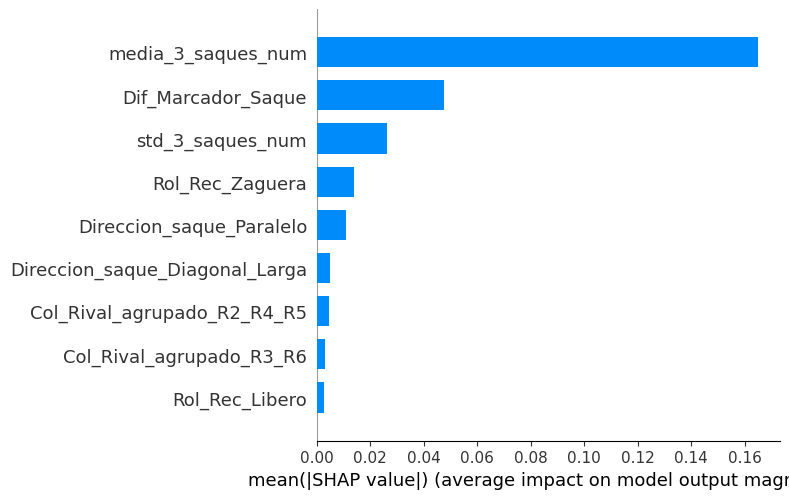

In [ ]:
explainer_1 = shap.TreeExplainer(modelo_rf_1)
shap_values_1 = explainer_1.shap_values(X1_test)

print("🔍 SHAP Summary – Jugadora 1")
shap.summary_plot(shap_values_1, X1_test, plot_type="bar")

🔍 SHAP Summary – Jugadora 2


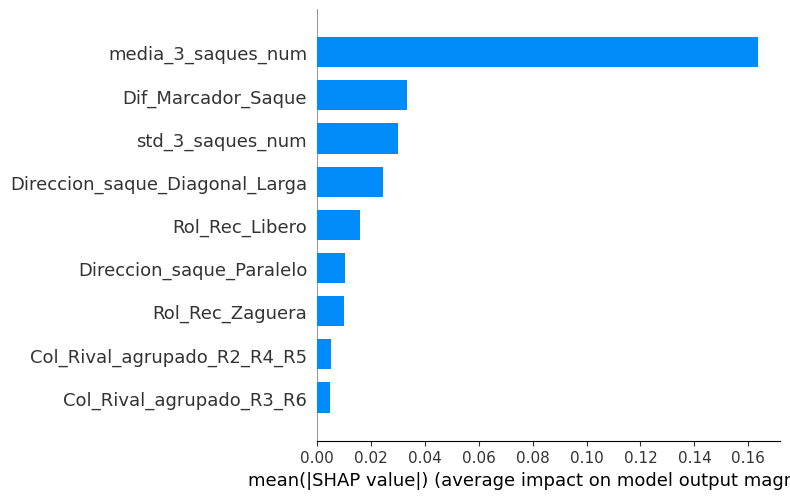

In [ ]:
explainer_2 = shap.TreeExplainer(modelo_rf_2)
shap_values_2 = explainer_2.shap_values(X2_test)

print("🔍 SHAP Summary – Jugadora 2")
shap.summary_plot(shap_values_2, X2_test, plot_type="bar")

🔍 SHAP Summary – Jugadora 3


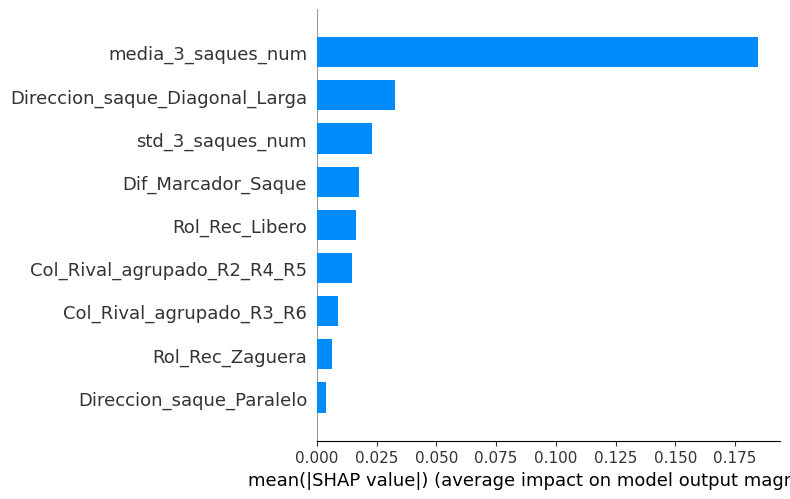

In [ ]:
explainer_3 = shap.TreeExplainer(modelo_rf_3)
shap_values_3 = explainer_3.shap_values(X3_test)

print("🔍 SHAP Summary – Jugadora 3")
shap.summary_plot(shap_values_3, X3_test, plot_type="bar")

# Código para entrenar XGBoost por jugadora

In [ ]:
modelo = XGBRegressor(n_estimators=100, learning_rate=0.1, random_state=seed)

In [ ]:
# Para conocer cual es el verdadero rendimiento del Xgboost con los diferentes modelos
from sklearn.model_selection import cross_val_score
scores = cross_val_score(modelo, X1, y1, cv=5, scoring='r2')  # o scoring='neg_mean_absolute_error'
print("R2 promedio:", scores.mean())


R2 promedio: -0.016873802805266937


In [ ]:
# Funcion para encontrar la mejor semilla de random_state para los dataframes (Lo dejo en un valor de rango bajo para que no demore ahora)
def encontrar_mejor_random_state(X, y, rango=10, test_size=0.2):
    resultados = []

    for seed in range(rango):
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=seed)

        modelo = XGBRegressor(n_estimators=100, learning_rate=0.1, random_state=seed)
        modelo.fit(X_train, y_train)
        pred = modelo.predict(X_test)

        r2 = r2_score(y_test, pred)
        mae = mean_absolute_error(y_test, pred)

        resultados.append({"seed": seed, "r2": r2, "mae": mae})

    df_resultados = pd.DataFrame(resultados)
    mejor_seed = df_resultados.sort_values("r2", ascending=False).iloc[0]

    print(f"🎯 Mejor semilla encontrada: {mejor_seed['seed']}")
    print(f"📈 R²: {mejor_seed['r2']:.4f}")
    print(f"📉 MAE: {mejor_seed['mae']:.4f}")

    return df_resultados, int(mejor_seed["seed"])

# USO EJEMPLO
df_resultados, mejor_seed = encontrar_mejor_random_state(X3, y3)

🎯 Mejor semilla encontrada: 4.0
📈 R²: 0.4731
📉 MAE: 0.2016


In [ ]:
# Función para entrenar y evaluar XGBoost por jugadora
def entrenar_xgboost(df, nombre_jugadora,num_random_state):
    X = df.drop(columns=["Val_Saque_num"])
    y = df["Val_Saque_num"]

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=num_random_state)

    modelo_xgb = XGBRegressor(objective='reg:squarederror', random_state=42)
    modelo_xgb.fit(X_train, y_train)

    y_pred = modelo_xgb.predict(X_test)

    r2 = r2_score(y_test, y_pred)
    mae = mean_absolute_error(y_test, y_pred)
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))

    print(f"📊 Resultados XGBoost – {nombre_jugadora}")
    print(f"R²: {r2:.4f}")
    print(f"MAE: {mae:.4f}")
    print(f"RMSE: {rmse:.4f}")

    return modelo_xgb, X_train, X_test, y_train, y_test

# Ejecutar para cada jugadora
modelo_xgb_1, X1_train, X1_test, y1_train, y1_test = entrenar_xgboost(Saques_Jug1_final, "Jugadora 1",6782)
modelo_xgb_2, X2_train, X2_test, y2_train, y2_test = entrenar_xgboost(Saques_Jug2_final, "Jugadora 2",77)
modelo_xgb_3, X3_train, X3_test, y3_train, y3_test = entrenar_xgboost(Saques_Jug3_final, "Jugadora 3",5139)

📊 Resultados XGBoost – Jugadora 1
R²: 0.6653
MAE: 0.1599
RMSE: 0.2133
📊 Resultados XGBoost – Jugadora 2
R²: 0.7073
MAE: 0.1176
RMSE: 0.1545
📊 Resultados XGBoost – Jugadora 3
R²: 0.6312
MAE: 0.1424
RMSE: 0.1903


In [ ]:
# Mostrar pesos de predictores del modelo XGBoost para jugadora 1
importancias = pd.Series(modelo_xgb_1.feature_importances_, index=X1_train.columns)
importancias.sort_values(ascending=False)

,0
media_3_saques_num,0.238100
Direccion_saque_Diagonal_Larga,0.209325
std_3_saques_num,0.151860
Rol_Rec_Zaguera,0.140879
Dif_Marcador_Saque,0.109279
Direccion_saque_Paralelo,0.073828
Rol_Rec_Libero,0.040006
Col_Rival_agrupado_R2_R4_R5,0.028592
Col_Rival_agrupado_R3_R6,0.008130


In [ ]:
# Mostrar pesos de predictores del modelo XGBoost para jugadora 2
importancias = pd.Series(modelo_xgb_2.feature_importances_, index=X2_train.columns)
importancias.sort_values(ascending=False)

,0
media_3_saques_num,0.345726
Col_Rival_agrupado_R3_R6,0.124194
Direccion_saque_Diagonal_Larga,0.123736
Rol_Rec_Libero,0.115126
Dif_Marcador_Saque,0.096325
Col_Rival_agrupado_R2_R4_R5,0.078042
std_3_saques_num,0.042174
Direccion_saque_Paralelo,0.040529
Rol_Rec_Zaguera,0.034148


In [ ]:
# Mostrar pesos de predictores del modelo XGBoost para jugadora 3
importancias = pd.Series(modelo_xgb_3.feature_importances_, index=X3_train.columns)
importancias.sort_values(ascending=False)

,0
media_3_saques_num,0.215481
Col_Rival_agrupado_R3_R6,0.186074
Direccion_saque_Paralelo,0.127900
Col_Rival_agrupado_R2_R4_R5,0.116401
Rol_Rec_Libero,0.097795
Direccion_saque_Diagonal_Larga,0.089523
std_3_saques_num,0.087994
Dif_Marcador_Saque,0.060532
Rol_Rec_Zaguera,0.018300


In [ ]:
X1_train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 93 entries, 102 to 40
Data columns (total 9 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Dif_Marcador_Saque              93 non-null     int64  
 1   media_3_saques_num              93 non-null     float64
 2   std_3_saques_num                93 non-null     float64
 3   Rol_Rec_Libero                  93 non-null     bool   
 4   Rol_Rec_Zaguera                 93 non-null     bool   
 5   Direccion_saque_Diagonal_Larga  93 non-null     bool   
 6   Direccion_saque_Paralelo        93 non-null     bool   
 7   Col_Rival_agrupado_R2_R4_R5     93 non-null     bool   
 8   Col_Rival_agrupado_R3_R6        93 non-null     bool   
dtypes: bool(6), float64(2), int64(1)
memory usage: 3.5 KB


In [ ]:
# Conversión obligatoria a float
X1_train = X1_train.astype(float)
X1_test = X1_test.astype(float)
# Conversión obligatoria a float
X2_train = X2_train.astype(float)
X2_test = X2_test.astype(float)
# Conversión obligatoria a float
X3_train = X3_train.astype(float)
X3_test = X3_test.astype(float)

🌟 SHAP Summary - Jugadora 1


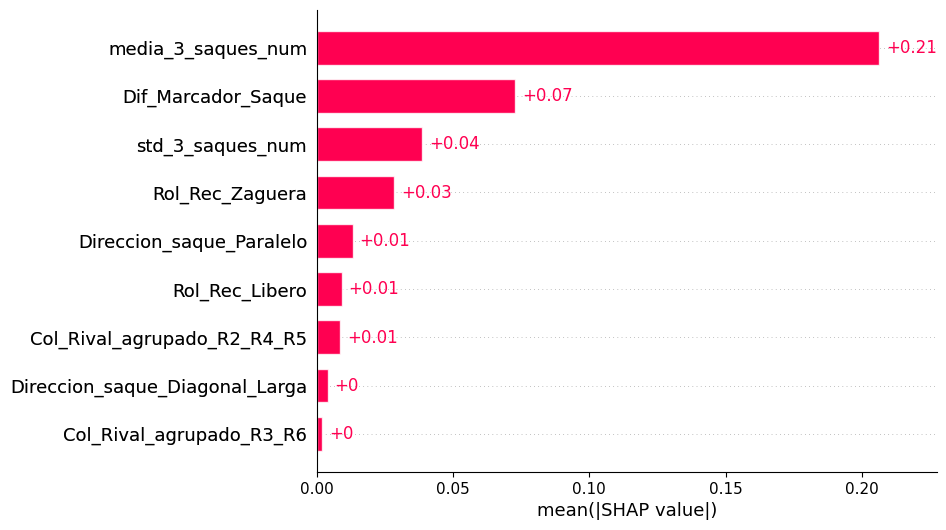

In [ ]:
# === SHAP EXPLICABILIDAD - Jugadora 1 ===
explainer1 = shap.Explainer(modelo_xgb_1, X1_train)
shap_values1 = explainer1(X1_test)
print("🌟 SHAP Summary - Jugadora 1")
shap.plots.bar(shap_values1, max_display=10)
plt.show()


🌟 SHAP Summary - Jugadora 2


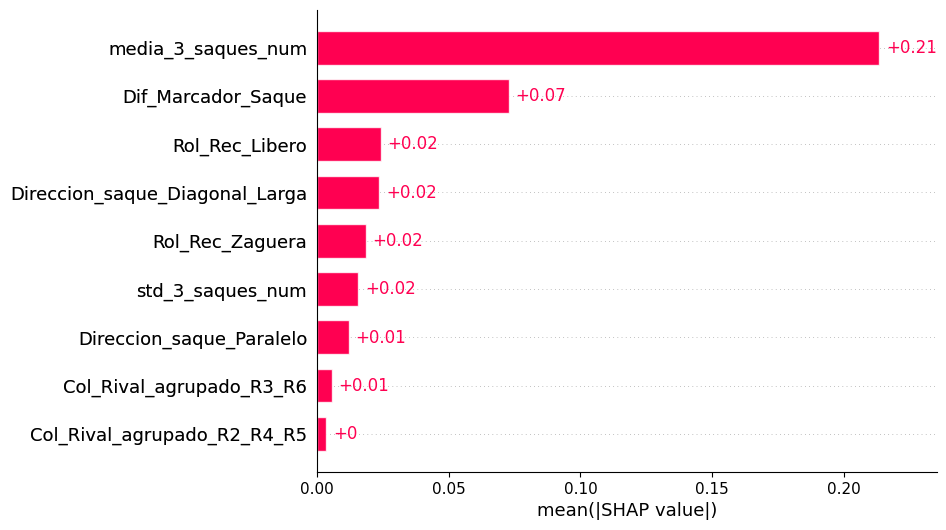

In [ ]:
# === SHAP EXPLICABILIDAD - Jugadora 2 ===
explainer2 = shap.Explainer(modelo_xgb_2, X2_train)
shap_values2 = explainer2(X2_test)
print("🌟 SHAP Summary - Jugadora 2")
shap.plots.bar(shap_values2, max_display=10)
plt.show()

🌟 SHAP Summary - Jugadora 3


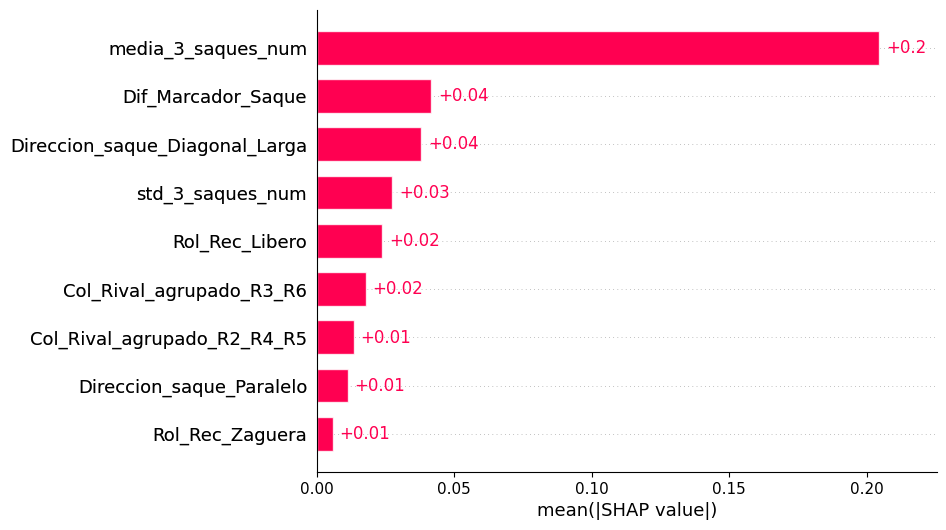

In [ ]:
# === SHAP EXPLICABILIDAD - Jugadora 3 ===
explainer3 = shap.Explainer(modelo_xgb_3, X3_train)
shap_values3 = explainer3(X3_test)
print("🌟 SHAP Summary - Jugadora 3")
shap.plots.bar(shap_values3, max_display=10)
plt.show()

In [ ]:
# === Jugadora 1 ===
explainer1 = lime.lime_tabular.LimeTabularExplainer(
    training_data=X1_train.values,
    feature_names=features,
    mode='regression',
    random_state=42
)

# Ejemplo sobre el registro 11 del test
i = 11
exp1 = explainer1.explain_instance(
    X1_test.values[i],
    modelo_xgb_1.predict,
    num_features=len(features)
)
print("📌 LIME – Jugadora 1")
exp1.show_in_notebook(show_table=True)

📌 LIME – Jugadora 1


In [ ]:
# === Jugadora 2 ===
explainer2 = lime.lime_tabular.LimeTabularExplainer(
    training_data=X2_train.values,
    feature_names=features,
    mode='regression',
    random_state=42
)
print("📌 LIME – Jugadora 2")
exp2 = explainer2.explain_instance(
    X2_test.values[i],
    modelo_xgb_2.predict,
    num_features=len(features)
)
exp2.show_in_notebook(show_table=True)


📌 LIME – Jugadora 2


In [ ]:

# === Jugadora 3 ===
explainer3 = lime.lime_tabular.LimeTabularExplainer(
    training_data=X3_train.values,
    feature_names=features,
    mode='regression',
    random_state=42
)
print("📌 LIME – Jugadora 3")
exp3 = explainer3.explain_instance(
    X3_test.values[i],
    modelo_xgb_3.predict,
    num_features=len(features)
)
exp3.show_in_notebook(show_table=True)

📌 LIME – Jugadora 3


# SHAP para REGRESION LINEAL MULTIVARIABLE

📌 Jugadora 1 - SHAP


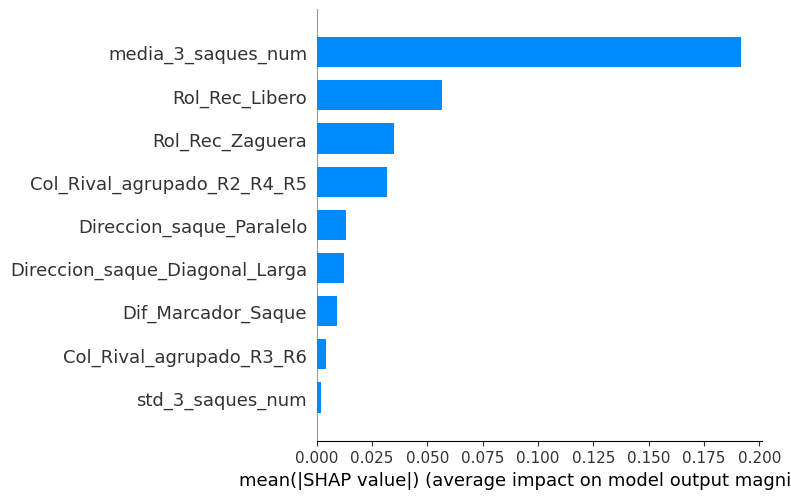

In [ ]:
print("📌 Jugadora 1 - SHAP")
explainer_lin1 = shap.Explainer(MiModelo, X1_train.values)
shap_values_lin1 = explainer_lin1(X1_test)
shap.summary_plot(shap_values_lin1, X1_test, plot_type="bar")

📌 Jugadora 2 - SHAP


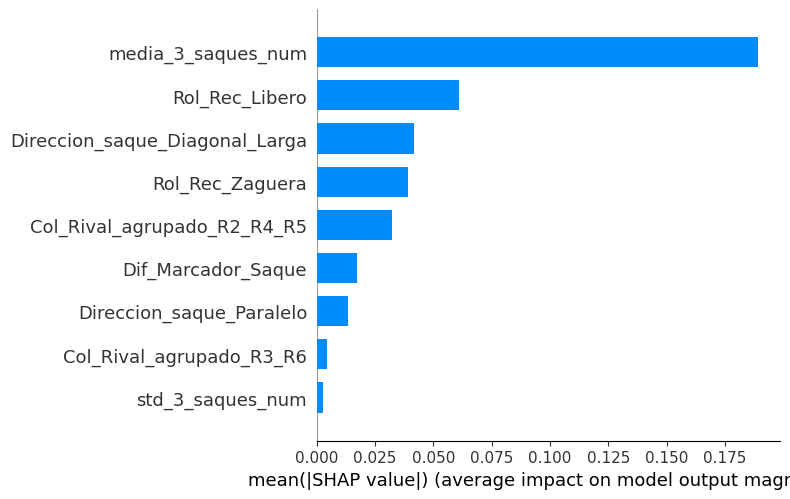

In [ ]:
print("📌 Jugadora 2 - SHAP")
explainer_lin2 = shap.Explainer(MiModelo, X2_train)
shap_values_lin2 = explainer_lin2(X2_test)
shap.summary_plot(shap_values_lin2, X2_test, plot_type="bar")

📌 Jugadora 3 - SHAP


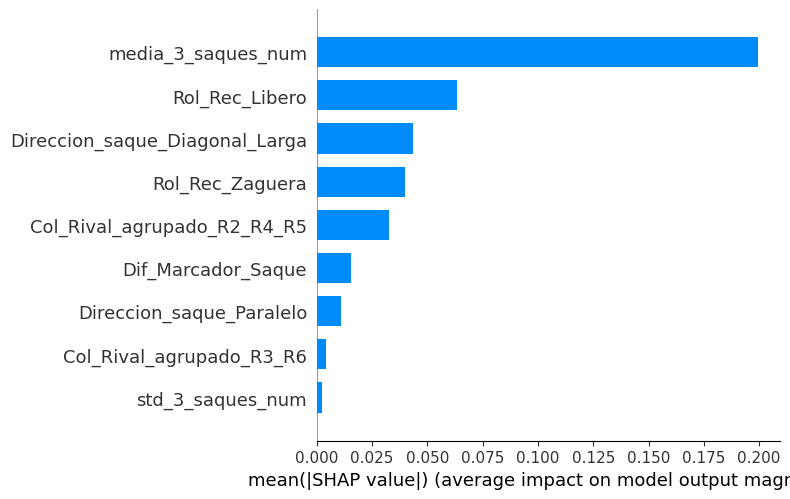

In [ ]:
print("📌 Jugadora 3 - SHAP")
explainer_lin3 = shap.Explainer(MiModelo, X3_train)
shap_values_lin3 = explainer_lin3(X3_test)
shap.summary_plot(shap_values_lin3, X3_test, plot_type="bar")